In [59]:
#Import your dataset
file_path_annotations = '/Users/yuen@backbase.com/Downloads/School/Emorec/emo-rec/data/processed_annotations.csv'
file_path_images1 = '/Users/yuen@backbase.com/Downloads/School/Emorec/emo-rec/data/Run_1'
file_path_images2 = '/Users/yuen@backbase.com/Downloads/School/Emorec/emo-rec/data/Run_2'

# Exploring Dataset 

In [50]:
import pandas as pd

df = pd.read_csv(file_path_annotations)
display(df.head())

,index,user,image_path,tags,age,valence,arousal,emotion,dec_factors,ambiguity,datetime
0,0,5fd97d5b40332e276ea58209,/Run_2/Loving toddlers sports/haiti-kids.jpg,Undefined,Children,0,2,Trust,"BodyLanguage,FacialExpression",0,2023-09-01 00:00:00.000000
1,5,5fd97d5b40332e276ea58209,/Run_2/Frustrated forty-something office/team-...,Undefined,Young Adults,0,2,Interest,FacialExpression,0,2023-09-01 00:00:00.000000
2,6,5985f6bdeef500000111db98,/Run_1/Violent youth festival/1042373588.jpg,Undefined,Young Adults,2,2,Interest,BodyLanguage,3,2023-09-01 00:00:00.000000
3,7,5985f6bdeef500000111db98,/Run_2/Remorseful toddlers court of law/dcfs-c...,Undefined,Adults,1,2,Interest,"BodyLanguage,FacialExpression",4,2023-09-01 00:00:00.000000
4,8,5fd97d5b40332e276ea58209,/Run_2/Shame elderly sports/3364887-46.jpg,Undefined,Adults,0,3,Apprehension,ConflictCtxtPerson,0,2023-09-01 00:00:00.000000


In [51]:
print("Number of rows:", len(df))

print("\nNumber of unique entries per column:")
for col in df.columns:
    print(f"- {col}: {df[col].nunique()}")

Number of rows: 19738

Number of unique entries per column:
- index: 19738
- user: 665
- image_path: 19738
- tags: 47
- age: 34
- valence: 7
- arousal: 7
- emotion: 24
- dec_factors: 58
- ambiguity: 7
- datetime: 18324


In [58]:
# Create a DataFrame from the analysis
image_analysis_details = []

for index, row in image_analysis_df.iterrows():
    image_analysis_details.append({
        "Image Index": index + 1,
        "File Path": row['file_path'],
        "File Size (bytes)": row['file_size'],
        "Width (pixels)": row['width'],
        "Height (pixels)": row['height'],
        "Format": row['format']
    })

# Convert the list of dictionaries to a DataFrame
detailed_image_analysis_df = pd.DataFrame(image_analysis_details)

# Display the DataFrame
display(detailed_image_analysis_df)


,Image Index,File Path,File Size (bytes),Width (pixels),Height (pixels),Format
0,1,/Users/yuen@backbase.com/Downloads/School/Emor...,230811,1400,933,JPEG
1,2,/Users/yuen@backbase.com/Downloads/School/Emor...,146700,1024,683,JPEG
2,3,/Users/yuen@backbase.com/Downloads/School/Emor...,668008,1024,768,JPEG
3,4,/Users/yuen@backbase.com/Downloads/School/Emor...,130056,1200,675,JPEG
4,5,/Users/yuen@backbase.com/Downloads/School/Emor...,507608,1200,792,JPEG
...,...,...,...,...,...,...
19228,19229,/Users/yuen@backbase.com/Downloads/School/Emor...,233829,1200,630,JPEG
19229,19230,/Users/yuen@backbase.com/Downloads/School/Emor...,95563,960,540,JPEG
19230,19231,/Users/yuen@backbase.com/Downloads/School/Emor...,121298,1024,542,JPEG
19231,19232,/Users/yuen@backbase.com/Downloads/School/Emor...,137144,960,720,JPEG


# Match Annotations & Images

In [52]:
import os

# Ensure image_files is defined
image_files = []
for directory in [file_path_images1, file_path_images2]:
    if os.path.exists(directory):
        for root, _, files in os.walk(directory):
            for file in files:
                if file.endswith(('.jpg', '.jpeg', '.png')):
                    image_files.append(os.path.join(root, file))

# Normalize the image paths in the DataFrame
base_dir = os.path.commonpath([file_path_images1, file_path_images2])
df['normalized_image_path'] = df['image_path'].apply(lambda x: os.path.normpath(os.path.join(base_dir, x.lstrip('/'))))

# Create sets for comparison
annotated_image_paths = set(df['normalized_image_path'])
image_paths_set = set(os.path.normpath(p) for p in image_files)

# DataFrame of annotations without matching images
df_annotations_without_image = df[df['normalized_image_path'].isin([p for p in annotated_image_paths if p not in image_paths_set])]
print(f"Number of annotations without matching images: {len(df_annotations_without_image)}")
display(df_annotations_without_image)

# DataFrame of images without matching annotations
df_images_without_annotation = pd.DataFrame({'image_path': list(image_paths_set - annotated_image_paths)})
print(f"Number of images without matching annotations: {len(df_images_without_annotation)}")
display(df_images_without_annotation)

Number of annotations without matching images: 1011


,index,user,image_path,tags,age,valence,arousal,emotion,dec_factors,ambiguity,datetime,normalized_image_path
8,17,5fd97d5b40332e276ea58209,/Run_1/Accepting children school/whitecoatcere...,Undefined,Young Adults,0,0,Joy,FacialExpression,0,2023-09-01 00:00:00.000000,/Users/yuen@backbase.com/Downloads/School/Emor...
33,59,5e9820b9c63c530008087a8c,/Run_2/Comforting adolescents playground/5edf6...,Undefined,"Children,Adults",2,5,Joy,Undefined,0,2023-09-01 00:00:00.000000,/Users/yuen@backbase.com/Downloads/School/Emor...
36,62,5fd97d5b40332e276ea58209,/Run_2/Worry retiree prison/170412-O-ZZ999-412...,Undefined,Seniors,0,2,Acceptance,"BodyLanguage,FacialExpression",0,2023-09-01 00:00:00.000000,/Users/yuen@backbase.com/Downloads/School/Emor...
40,73,5fd97d5b40332e276ea58209,/Run_2/Worry seniors fighting/463542923.jpg,Undefined,Adults,0,1,Anticipation,ConflictCtxtPerson,0,2023-09-01 00:00:00.000000,/Users/yuen@backbase.com/Downloads/School/Emor...
46,91,5985f6bdeef500000111db98,/Run_2/Appalled youth court of law/service_2.jpg,Undefined,Adults,1,1,Serenity,FacialExpression,2,2023-09-01 00:00:00.000000,/Users/yuen@backbase.com/Downloads/School/Emor...
...,...,...,...,...,...,...,...,...,...,...,...,...
19696,31634,5fdf808af53c7a7e9199b430,/Run_2/Depressed soldiers holding/iStock-84718...,Undefined,"Children,Adults",1,3,Trust,"Context,FacialExpression",3,2023-12-21 18:20:15.259290,/Users/yuen@backbase.com/Downloads/School/Emor...
19716,31658,6522a42f39b5bd8f96735aa9,/Run_2/Frustrated youth shop/d3s_0659.jpg,Undefined,Adults,1,5,Anticipation,"FacialExpression,Staging",1,2023-12-21 18:39:19.776811,/Users/yuen@backbase.com/Downloads/School/Emor...
19727,31671,6522a42f39b5bd8f96735aa9,/Run_2/Scared midlife playing/3I67KO2O5JFCDMJF...,Undefined,Adults,-2,4,Rage,"Context,FacialExpression",2,2023-12-21 18:44:42.147747,/Users/yuen@backbase.com/Downloads/School/Emor...
19728,31672,6522a42f39b5bd8f96735aa9,/Run_2/Embarrassed adults movie/chappie11-1.jpg,Undefined,Adults,-2,4,Grief,"BodyLanguage,Context,FacialExpression",2,2023-12-21 18:45:05.843812,/Users/yuen@backbase.com/Downloads/School/Emor...


Number of images without matching annotations: 506


,image_path
0,/Users/yuen@backbase.com/Downloads/School/Emor...
1,/Users/yuen@backbase.com/Downloads/School/Emor...
2,/Users/yuen@backbase.com/Downloads/School/Emor...
3,/Users/yuen@backbase.com/Downloads/School/Emor...
4,/Users/yuen@backbase.com/Downloads/School/Emor...
...,...
501,/Users/yuen@backbase.com/Downloads/School/Emor...
502,/Users/yuen@backbase.com/Downloads/School/Emor...
503,/Users/yuen@backbase.com/Downloads/School/Emor...
504,/Users/yuen@backbase.com/Downloads/School/Emor...


In [53]:
# Filter df to only include rows with both annotation and matching image
matched_image_paths = set(df['normalized_image_path']).intersection(image_paths_set)
df_matched = df[df['normalized_image_path'].isin(matched_image_paths)].copy()

# Use df_matched for all further annotation analysis
print(f"Number of matched annotations: {len(df_matched)}")
display(df_matched.head())

Number of matched annotations: 18727


,index,user,image_path,tags,age,valence,arousal,emotion,dec_factors,ambiguity,datetime,normalized_image_path
0,0,5fd97d5b40332e276ea58209,/Run_2/Loving toddlers sports/haiti-kids.jpg,Undefined,Children,0,2,Trust,"BodyLanguage,FacialExpression",0,2023-09-01 00:00:00.000000,/Users/yuen@backbase.com/Downloads/School/Emor...
1,5,5fd97d5b40332e276ea58209,/Run_2/Frustrated forty-something office/team-...,Undefined,Young Adults,0,2,Interest,FacialExpression,0,2023-09-01 00:00:00.000000,/Users/yuen@backbase.com/Downloads/School/Emor...
2,6,5985f6bdeef500000111db98,/Run_1/Violent youth festival/1042373588.jpg,Undefined,Young Adults,2,2,Interest,BodyLanguage,3,2023-09-01 00:00:00.000000,/Users/yuen@backbase.com/Downloads/School/Emor...
3,7,5985f6bdeef500000111db98,/Run_2/Remorseful toddlers court of law/dcfs-c...,Undefined,Adults,1,2,Interest,"BodyLanguage,FacialExpression",4,2023-09-01 00:00:00.000000,/Users/yuen@backbase.com/Downloads/School/Emor...
4,8,5fd97d5b40332e276ea58209,/Run_2/Shame elderly sports/3364887-46.jpg,Undefined,Adults,0,3,Apprehension,ConflictCtxtPerson,0,2023-09-01 00:00:00.000000,/Users/yuen@backbase.com/Downloads/School/Emor...


# Data Analysis

/var/folders/0_/3pl6888s5j13pjsxp4wzz1s00000gp/T/ipykernel_26700/812538247.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=emotion_counts.index, y=emotion_counts.values, palette='viridis')


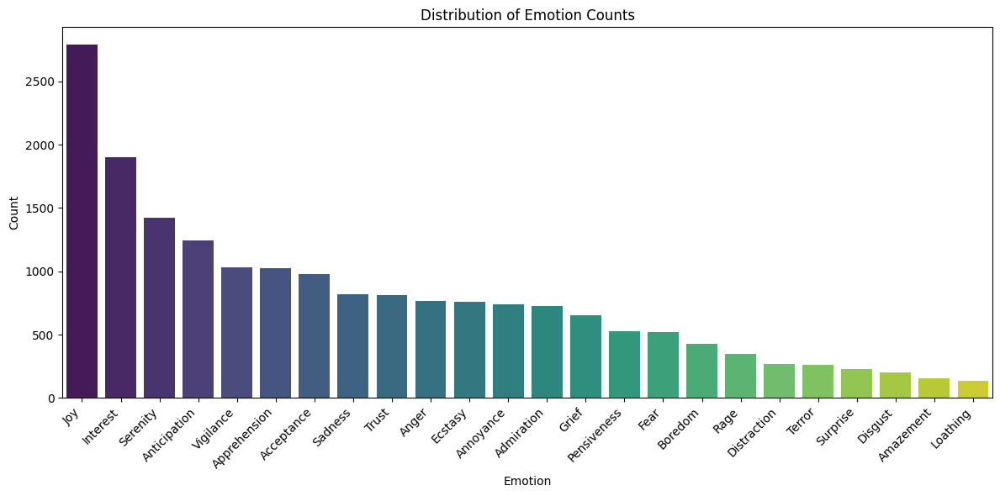

In [24]:
# Analysis: Count of each unique emotion
emotion_counts = df_matched['emotion'].value_counts().sort_values(ascending=False)

# Visualisation: Bar plot of emotion counts
plt.figure(figsize=(12, 6))
sns.barplot(x=emotion_counts.index, y=emotion_counts.values, palette='viridis')
plt.xticks(rotation=45, ha='right')
plt.title('Distribution of Emotion Counts')
plt.xlabel('Emotion')
plt.ylabel('Count')
plt.tight_layout()
plt.show()

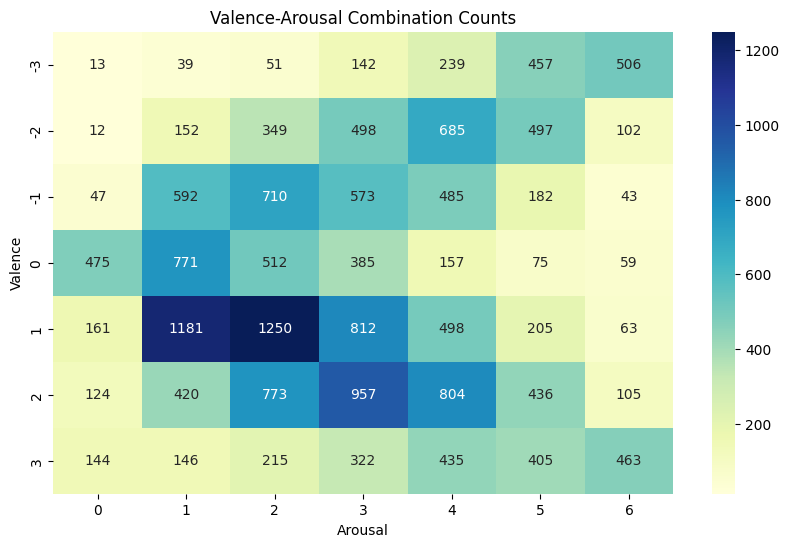

In [54]:
# Count of each valence-arousal combination
comb_counts = df_matched.groupby(['valence', 'arousal']).size().reset_index(name='count')

import seaborn as sns
import matplotlib.pyplot as plt

pivot_table = comb_counts.pivot(index='valence', columns='arousal', values='count')
plt.figure(figsize=(10, 6))
sns.heatmap(pivot_table, annot=True, fmt='d', cmap='YlGnBu')
plt.title('Valence-Arousal Combination Counts')
plt.ylabel('Valence')
plt.xlabel('Arousal')
plt.show()

In general, positive valence is associated with positive emotions (e.g., Happiness, Excitement), while negative valence is linked to negative emotions (e.g., Sadness, Anger).
People tend to feel negative emotions more intensely (higher arousal) than positive ones.


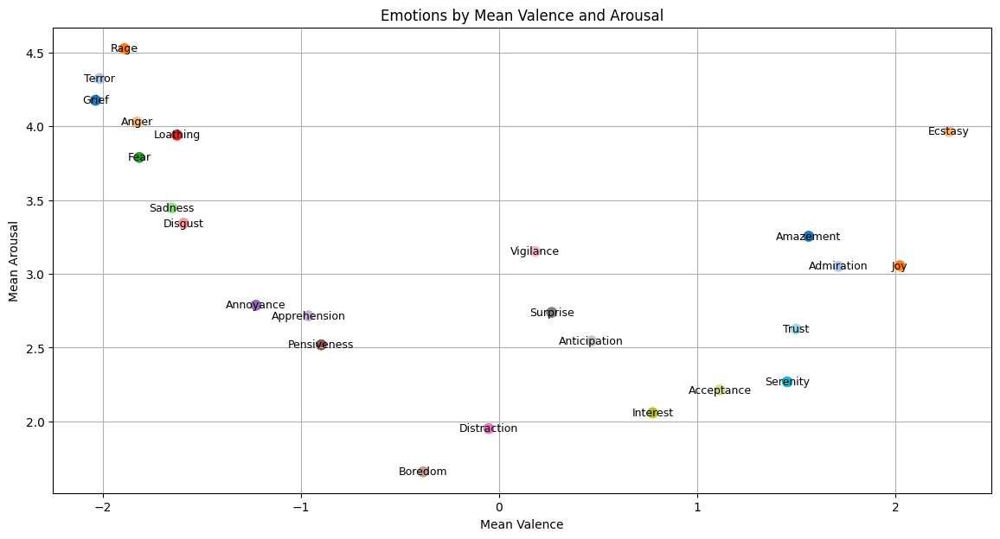

valence           arousal        
                  mean max min      mean max min
emotion                                         
Grief        -2.035115   3  -3  4.177099   6   0
Terror       -2.015267   3  -3  4.324427   6   0
Rage         -1.889855   3  -3  4.527536   6   0
Anger        -1.826371   3  -3  4.030026   6   0
Fear         -1.814532   3  -3  3.789675   6   0
Sadness      -1.649939   3  -3  3.446756   6   0
Loathing     -1.625000   3  -3  3.941176   6   0
Disgust      -1.590909   3  -3  3.343434   6   1
Annoyance    -1.225981   3  -3  2.787551   6   0
Apprehension -0.961052   3  -3  2.715677   6   0
Pensiveness  -0.896947   3  -3  2.519084   6   0
Boredom      -0.382075   3  -3  1.658019   6   0
Distraction  -0.052045   3  -3  1.951673   6   0
Vigilance     0.181994   3  -3  3.151985   6   0
Surprise      0.265487   3  -3  2.738938   6   0
Anticipation  0.466613   3  -3  2.545455   6   0
Interest      0.775789   3  -3  2.058421   6   0
Acceptance    1.113730   3  -3  2.213115   6   0
Serenity      1.453906   3  -3  2.268121   6   0
Trust         1.498160   3  -3  2.625767   6   0
Amazement     1.562092   3  -3  3.254902   6   0
Admiration    1.711538   3  -3  3.050824   6   0
Joy           2.021513   3  -3  3.055575   6   0
Ecstasy       2.269129   3  -3  3.965699   6   0

In [42]:
# Calculate the mean valence and arousal for each emotion
emotion_va_summary = df_matched.groupby('emotion')[['valence', 'arousal']].agg(['mean', 'max', 'min']).sort_values(('valence', 'mean'))

# Visualize the relationship between emotions and their average valence/arousal
plt.figure(figsize=(14, 7))
sns.scatterplot(
    x=emotion_va_summary[('valence', 'mean')],
    y=emotion_va_summary[('arousal', 'mean')],
    hue=emotion_va_summary.index,
    palette='tab20',
    s=100,
    legend=False
)

print("In general, positive valence is associated with positive emotions (e.g., Happiness, Excitement), while negative valence is linked to negative emotions (e.g., Sadness, Anger).")
print("People tend to feel negative emotions more intensely (higher arousal) than positive ones.")

for emotion, row in emotion_va_summary.iterrows():
    plt.text(row[('valence', 'mean')], row[('arousal', 'mean')], emotion, fontsize=9, ha='center', va='center')

plt.title('Emotions by Mean Valence and Arousal')
plt.xlabel('Mean Valence')
plt.ylabel('Mean Arousal')
plt.grid(True)
plt.show()

# Optionally, show the stats table
display(emotion_va_summary)

# Cases: Negative Emotion (e.g. Terror) has Positive Valence

In [39]:
# Create terror_df by filtering rows where emotion is "Terror"
terror_df = df_matched[df_matched['emotion'] == 'Terror']

# Filter terror_df for rows with positive valence
terror_positive_valence_df = terror_df[terror_df['valence'] > 0]
display(terror_positive_valence)

,index,user,image_path,tags,age,valence,arousal,emotion,dec_factors,ambiguity,datetime,normalized_image_path
986,1835,5eb4021cb97d6b20fdec1c27,/Run_2/Seducing soldiers studio/Habanera-Photo...,Undefined,Adults,1,2,Terror,Neutral,1,2023-09-01 00:00:00.000000,/Users/yuen@backbase.com/Downloads/School/Emor...
1054,1973,60f41ae35227aa02240ba0d9,/Run_2/Peaceful seniors army/GettyImages-11905...,Undefined,Adults,2,3,Terror,"BodyLanguage,FacialExpression",3,2023-09-01 00:00:00.000000,/Users/yuen@backbase.com/Downloads/School/Emor...
1059,1980,60f41ae35227aa02240ba0d9,/Run_2/Guilt forty-something protest/656ce37d-...,Undefined,Adults,3,6,Terror,"BodyLanguage,FacialExpression",3,2023-09-01 00:00:00.000000,/Users/yuen@backbase.com/Downloads/School/Emor...
4297,7183,60d1b7642d082fa4cebddfd2,/Run_2/Fearful adults fall/niagara-falls-haunt...,Undefined,Adults,2,6,Terror,FacialExpression,0,2023-09-22 13:23:51.574851,/Users/yuen@backbase.com/Downloads/School/Emor...
5009,8288,611e1f608f92b6c9b825bcca,/Run_2/Exasperated people shop/mta-riders-tire...,Undefined,Young Adults,2,5,Terror,BodyLanguage,5,2023-10-05 16:02:40.586049,/Users/yuen@backbase.com/Downloads/School/Emor...
5033,8335,611e1f608f92b6c9b825bcca,/Run_2/Disgusted thirty-something soccer/Canad...,Undefined,Young Adults,3,5,Terror,FacialExpression,4,2023-10-05 16:05:33.947632,/Users/yuen@backbase.com/Downloads/School/Emor...
5042,8359,611e1f608f92b6c9b825bcca,/Run_2/Outraged teenagers gathering/3CA3277200...,Undefined,Young Adults,2,4,Terror,Context,4,2023-10-05 16:07:32.603951,/Users/yuen@backbase.com/Downloads/School/Emor...
5106,8460,61604e86279e4346e5fe6f2d,/Run_2/Violent adolescents army/file-20180514-...,Undefined,"Adults,Seniors",3,3,Terror,"ConflictCtxtPerson,FacialExpression",1,2023-10-05 16:15:11.603158,/Users/yuen@backbase.com/Downloads/School/Emor...
5503,9085,61138add299713969a18677d,/Run_2/Depressed retiree birthday/PKIFXZBJ3CN3...,Undefined,"Children,Adults",2,3,Terror,"BodyLanguage,FacialExpression,Staging",3,2023-10-17 14:25:15.431880,/Users/yuen@backbase.com/Downloads/School/Emor...
6340,10357,64fead10d35271cb8eafc1c2,/Run_2/Violent fifty-something court/1024x538_...,Undefined,"Young Adults,Adults",1,3,Terror,"BodyLanguage,FacialExpression,Staging",5,2023-11-10 14:24:41.906755,/Users/yuen@backbase.com/Downloads/School/Emor...


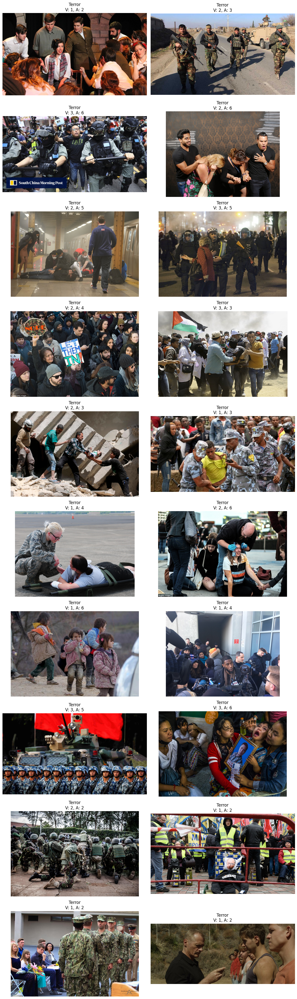

In [40]:
# Create a 10x2 grid with tall figure size
fig, axes = plt.subplots(10, 2, figsize=(12, 40))  # 10 rows, 2 columns, very tall figure
axes = axes.flatten()

displayed = 0
for _, row in terror_positive_valence_df.iterrows():
    if displayed >= 20:  # Show 20 images
        break

    img_path = row['normalized_image_path']
    if os.path.exists(img_path):
        try:
            img = Image.open(img_path)
            axes[displayed].imshow(img)
            axes[displayed].set_title(
                f"{row['emotion']}\nV: {row['valence']}, A: {row['arousal']}",
                fontsize=12,
            )
            axes[displayed].axis("off")
            displayed += 1
        except Exception as e:
            print(f"Skipping corrupted image: {img_path}")
            continue
    else:
        print(f"File not found: {img_path}")

plt.tight_layout()
plt.show()

Images Analysis

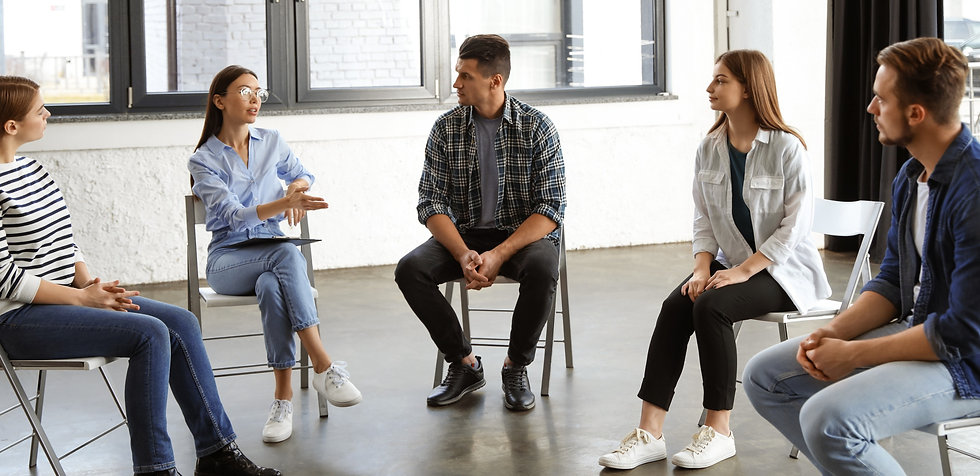

Displayed: 786c9d_10f7ff70cfb641b2869802f6b8ffd8e9~mv2.jpg


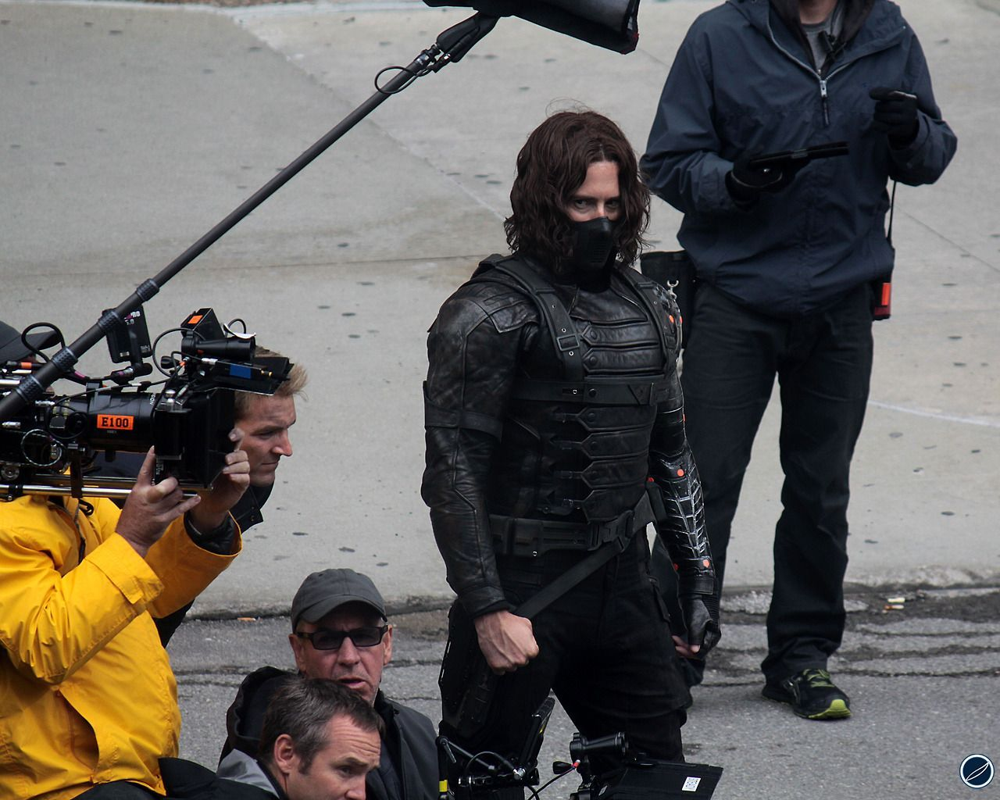

Displayed: winter-soldier-4.jpg


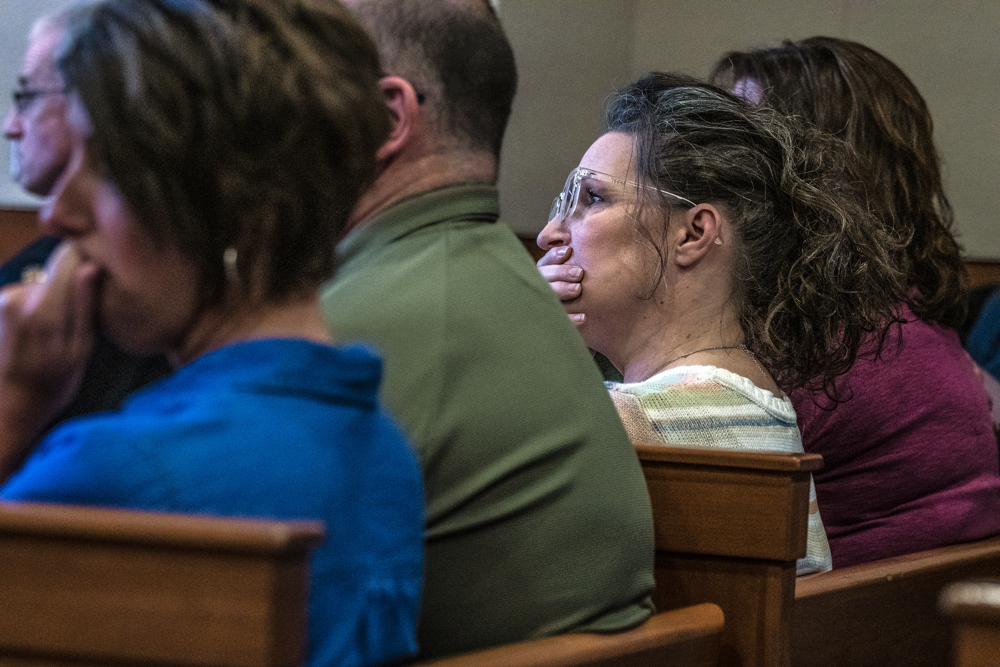

Displayed: WDH-PattersonPlea-032719-TK-18323a.jpg


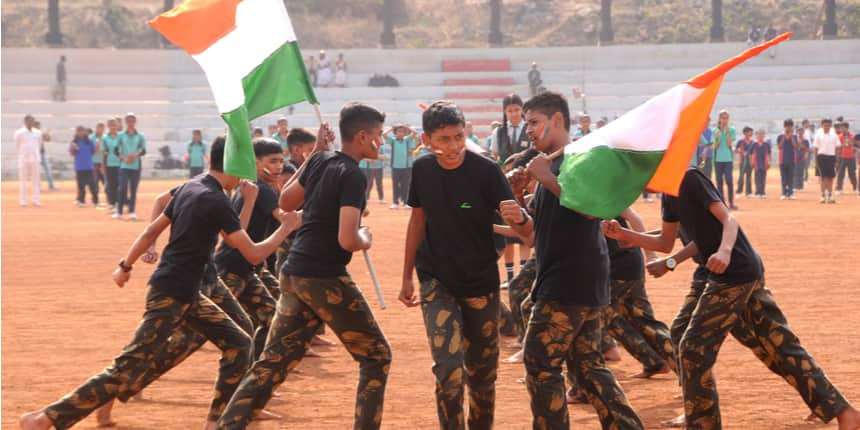

Displayed: Rashtriya-Military-School-Dholpur_.jpg


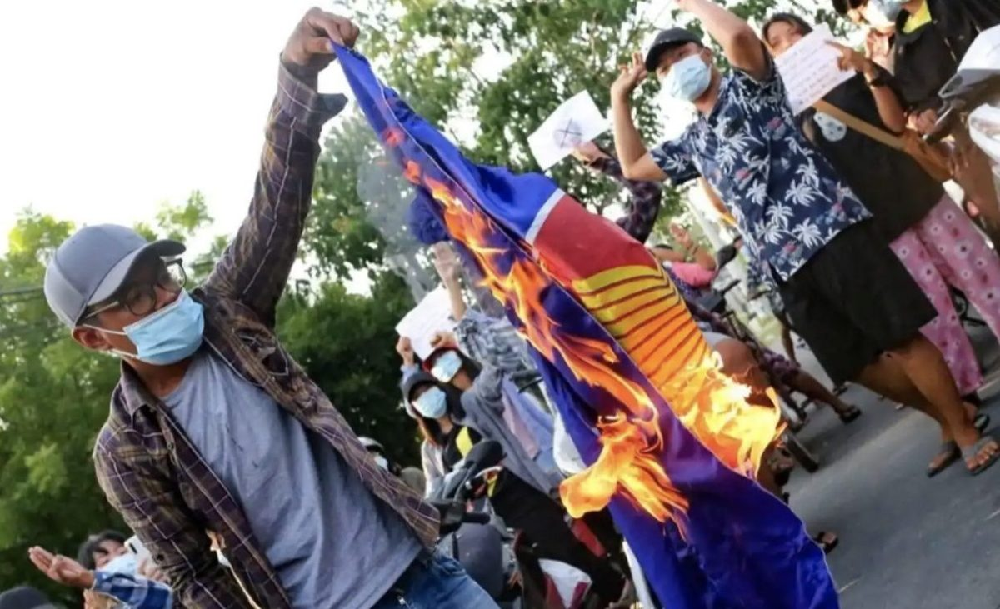

Displayed: Myanmar-ASEAN-Flag-Protest-June-5-2021-e1623410609549.jpg


In [36]:
from PIL import Image
import random
import os

# Display a few random images
num_images_to_display = 5
if image_files:
    random_images = random.sample(image_files, min(num_images_to_display, len(image_files)))

    for img_path in random_images:
        try:
            img = Image.open(img_path)
            display(img)
            print(f"Displayed: {os.path.basename(img_path)}")
        except Exception as e:
            print(f"Could not display {os.path.basename(img_path)}: {e}")
else:
    print(f"No image files found in {file_path_images1} or {file_path_images2}")